**This notebook is for evaluation of scAR on public CITEseq data.**
___

Import packages
==

In [1]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

In [2]:
import numpy as np
import os, glob, re
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from natsort import natsorted, ns
import scanpy as sc
import numba
import anndata as ad
from sklearn.metrics import r2_score
sc.settings.verbosity = 0  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()

scanpy==1.8.1 anndata==0.7.5 umap==0.4.6 numpy==1.21.4 scipy==1.6.2 pandas==1.3.2 scikit-learn==1.0.1 statsmodels==0.12.1 python-igraph==0.9.1 louvain==0.6.1 leidenalg==0.8.3


In [3]:
import spreen as sn

In [4]:
sc.settings.verbosity = 0  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
from matplotlib import rcParams
import umap
rcParams['figure.figsize'] = 3, 3

scanpy==1.8.1 anndata==0.7.5 umap==0.4.6 numpy==1.21.4 scipy==1.6.2 pandas==1.3.2 scikit-learn==1.0.1 statsmodels==0.12.1 python-igraph==0.9.1 louvain==0.6.1 leidenalg==0.8.3


# Plot setting

In [5]:
#publication quality plots
from matplotlib import pylab

def plot_setting():

    params = {'legend.fontsize': 5,
              'figure.facecolor':"w",
              'figure.figsize': (3, 2),
              'axes.labelsize': 6,
              'axes.titlesize': 6,
             'axes.linewidth': 0.5,
             'xtick.labelsize': 5,
             'ytick.labelsize': 5,
              # set tick width
              'xtick.major.size': 3.5,
              'xtick.major.width': 0.5,
              'xtick.minor.size': 2,
              'xtick.minor.width': 0.5,
              'xtick.color': 'black',
              'ytick.major.size': 3.5,
              'ytick.major.width': 0.5,
              'ytick.minor.size': 2,
              'ytick.minor.width': 0.5,
              'ytick.color': 'black',
             'pdf.fonttype': 42,
             'figure.autolayout': True,
             'axes.grid':False,
             "figure.dpi":200}

    # Set the global font to be DejaVu Sans, size 10 (or any other sans-serif font of your choice!)
    # pylab.rc('font',**{'family':'sans-serif','sans-serif':['DejaVu Sans'],'size':10});
    pylab.rc('font',**{'family':'sans-serif','sans-serif':['Arial'], 'size':6})

    # Set the font used for MathJax - more on this later
    # pylab.rc('mathtext',**{'default':'regular'});

    pylab.rcParams.update(params);

    sns.set_palette("muted");
    sns.set_style("ticks");
    sns.despine(offset=4, trim=True);

plot_setting()

<Figure size 600x400 with 0 Axes>

Metadata
====

### Read data

In [6]:
indir = "/da/onc/bfx/research/shengca1/public_data/10xgenomics/5k_pbmc_protein_v3/"
adata = sc.read_10x_mtx(indir+'/filtered_feature_bc_matrix', gex_only=False)
adata_raw = sc.read_10x_mtx(indir+'/raw_feature_bc_matrix',gex_only=False)

fb_filtered = adata[:,adata.var['feature_types'] == 'Antibody Capture'].to_df()
fb_raw = adata_raw[:,adata_raw.var['feature_types'] == 'Antibody Capture'].to_df()

adata = adata[:,adata.var['feature_types'] == 'Gene Expression']
adata_raw = adata_raw[:,adata_raw.var['feature_types'] == 'Gene Expression']

### Determine empty droplets

In [7]:
rank_UMIs = pd.DataFrame(adata_raw.X.sum(axis=1), index = adata_raw.obs_names, columns=['total_counts'])

rank_UMIs['droplets'] = 'droplets III'
rank_UMIs['droplets'] = rank_UMIs['droplets'].mask(rank_UMIs['total_counts']>45, 'droplets II')
rank_UMIs['droplets'] = rank_UMIs['droplets'].mask(rank_UMIs['total_counts']>100, 'droplets I')
rank_UMIs['droplets'] = rank_UMIs['droplets'].mask(rank_UMIs.index.isin(adata.obs_names), 'cells')
rank_UMIs = rank_UMIs.rename_axis('cells')
rank_UMIs = rank_UMIs.sort_values(by='total_counts', ascending=False).reset_index().rename_axis("rank").reset_index()
rank_UMIs = rank_UMIs.loc[rank_UMIs['total_counts']>0]
rank_UMIs = rank_UMIs.set_index('cells')

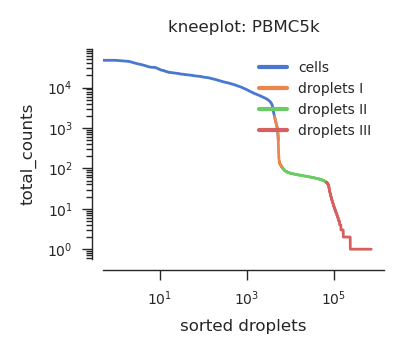

In [8]:
fig = plt.figure(figsize=(2,1.75))

ax = sns.lineplot(data = rank_UMIs,
                  x='rank',
                  y='total_counts',
                  hue='droplets',
                  markers=False,
                  lw=1,
                  rasterized=True)

ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('sorted droplets');
ax.legend(loc='upper right', ncol=1, title=None, frameon=False)
ax.set_title(f'kneeplot: PBMC5k');

sns.set_palette("muted")
sns.set_style("ticks")
sns.despine(offset=4, trim=False);

# fig.savefig('/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/figures/Fig4_CITEseq/PBMC5k_droplets_characterization.pdf', doi=200)

In [9]:
freq = pd.DataFrame(columns=adata_raw.var_names, index=['cells', 'droplets I', 'droplets II', 'droplets III'])

cell_droplets = adata_raw[adata_raw.obs_names.isin(rank_UMIs[rank_UMIs['droplets']=='cells'].index)].X.A.sum(axis=0)
freq.loc['cells']=cell_droplets/cell_droplets.sum()

droplets1 = adata_raw[adata_raw.obs_names.isin(rank_UMIs[rank_UMIs['droplets']=='droplets I'].index)].X.A.sum(axis=0)
freq.loc['droplets I']=droplets1/droplets1.sum()

droplets2 = adata_raw[adata_raw.obs_names.isin(rank_UMIs[rank_UMIs['droplets']=='droplets II'].index)].X.A.sum(axis=0)
freq.loc['droplets II']=droplets2/droplets2.sum()

droplets3 = adata_raw[adata_raw.obs_names.isin(rank_UMIs[rank_UMIs['droplets']=='droplets III'].index)].X.sum(axis=0)
freq.loc['droplets III']=droplets3/droplets3.sum()

In [10]:
dros1 = r2_score(freq.T['cells'], freq.T['droplets I'])
dros2 = r2_score(freq.T['cells'], freq.T['droplets II'])
dros3 = r2_score(freq.T['cells'], freq.T['droplets III'])

In [11]:
freq_unpivoted = freq.T.melt(id_vars=['cells'], var_name='droplets', value_name='fraction of genes')
freq_unpivoted['fraction of gene counts in cells (‰)'] = freq_unpivoted['cells'] * 1000
freq_unpivoted['fraction of gene counts in droplets (‰)'] = freq_unpivoted['fraction of genes'] * 1000

# freq.T.stack().to_frame('fraction').rename_axis(['genes', 'droplets']).reset_index()

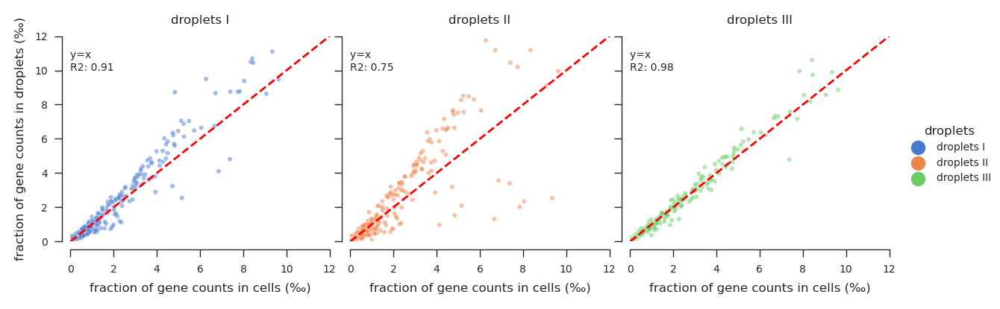

In [12]:
g = sns.relplot(data=freq_unpivoted,
                x="fraction of gene counts in cells (‰)",
                y="fraction of gene counts in droplets (‰)",
                col="droplets",
                hue='droplets',
                s=5,
                alpha=0.5,
                kind="scatter",
                height=2,
                rasterized=True,
               );

R2_dros = [dros1, dros2, dros3]
for i in range(3):
    g.axes[0,i].plot([0,12], [0,12], 'r--', linewidth = 1)
    g.axes[0,i].text(0, 10, f'y=x \nR2: {R2_dros[i]:.2f}', fontsize=5)
    
g.set_titles('{col_name}')
sns.set_palette("muted")
sns.set_style("ticks")
sns.despine(offset=4, trim=False);
g.set(xlim=(0,12), ylim=(0,12))
# plt.savefig('/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/figures/Fig4_CITEseq/PBMC5k_droplets_cell_correlation.pdf', doi=200)

In [13]:
empty_droplets = adata_raw[rank_UMIs[rank_UMIs['droplets']=='droplets III'].index][:, adata.var_names]
empty_profile = empty_droplets.X.sum(axis=0)/empty_droplets.X.sum()
pd.DataFrame(empty_profile, columns=adata.var_names).T.to_pickle('/da/onc/bfx/research/shengca1/public_data/10xgenomics/5k_pbmc_protein_v3/metadata/5k_pbmc_protein_empty_profile.pickle')

In [14]:
count_matrix = adata.to_df()
count_matrix.to_pickle('/da/onc/bfx/research/shengca1/public_data/10xgenomics/\
5k_pbmc_protein_v3/metadata/5k_pbmc_protein_count_matrix.pickle')

In [15]:
## Check feature barcodes

rank_UMIs_fb = fb_raw.sum(axis=1).to_frame('total_counts')
rank_UMIs_fb = rank_UMIs_fb[rank_UMIs_fb['total_counts']>0]
rank_UMIs_fb = rank_UMIs_fb.rename_axis('cells')
rank_UMIs_fb = rank_UMIs_fb.join(rank_UMIs[['droplets']], how='left')

In [16]:
# empty_droplet_in_fb = rank_UMIs_fb[rank_UMIs_fb['droplets'].isin(['droplets III'])]
empty_droplet_in_fb = rank_UMIs_fb[~rank_UMIs_fb['droplets'].isin(['cells', 'droplets I', 'droplets II', 'droplets III'])]

sample_frac = [0.0001, 0.0002, 0.0003, 0.0004, 0.0005,  0.0006, 0.0007, 0.0008, 0.0009, 0.001, 0.01, 0.1, 1]
# sample_frac = [0.0001, 0.001, 0.01, 0.1, 0.25, 0.5, 0.75, 1]
freq_fb = pd.DataFrame(columns=fb_raw.columns, index=sample_frac)

cell_droplets = fb_raw.loc[fb_raw.index.isin(rank_UMIs_fb[rank_UMIs_fb['droplets']=='cells'].index)].sum()
freq_fb.loc['cells']=cell_droplets/cell_droplets.sum()

r2_score_df =pd.DataFrame(index=pd.MultiIndex.from_product([range(1,11), sample_frac]), columns=['R2_score'])

for n_random in range(1,11):
    for frac in sample_frac:
        sampled_empty_fb = empty_droplet_in_fb.sample(frac=frac, axis=0)
        sampled_empty_fb
        sampled_droplets = fb_raw.loc[fb_raw.index.isin(sampled_empty_fb.index)].sum()
        freq_fb.loc[frac]=sampled_droplets/sampled_droplets.sum()

        r2_score_df.loc[(n_random, frac)] = r2_score(freq_fb.loc['cells'].sort_index(), freq_fb.loc[frac].sort_index())
        if n_random == 1:
            print(sampled_empty_fb.shape[0])

15
31
46
62
77
92
108
123
138
154
1539
15386
153865


In [17]:
freq_unpivoted = freq_fb.T.melt(id_vars=['cells'], var_name='droplets', value_name='fraction of genes')
freq_unpivoted['fraction of protein counts in cells (%)'] = freq_unpivoted['cells'] * 100
freq_unpivoted['fraction of protein counts in droplets (%)'] = freq_unpivoted['fraction of genes'] * 100

In [18]:
r2_score_df.index=r2_score_df.index.reorder_levels([1,0])

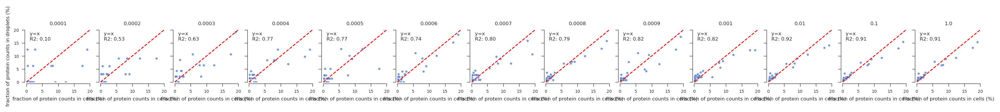

In [19]:
g = sns.relplot(data=freq_unpivoted,
                x="fraction of protein counts in cells (%)",
                y="fraction of protein counts in droplets (%)",
                col="droplets",
                # hue='droplets',
                s=8,
                alpha=0.75,
                kind="scatter",
                height=1.5,
                aspect=.85,
               );

for i,frac in enumerate(freq_unpivoted['droplets'].unique()):
    g.axes[0,i].plot([0, 20], [0, 20], 'r--', linewidth = 1)
    score = r2_score_df.loc[frac].mean()[0]
    g.axes[0,i].text(1, 16, f'y=x \nR2: {score:.2f}', fontsize=6)
    
g.set_titles('{col_name}')
sns.set_palette("muted")
sns.set_style("ticks")
sns.despine(offset=2, trim=False);
g.set(xlim=(0,20), ylim=(0,20))
# plt.savefig('/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/figures/Fig4_CITEseq/PBMC5k_droplets_cell_correlation_fb.pdf', doi=200)

In [20]:
r2_score_df = r2_score_df.rename_axis(['proportion of empty droplets','runs']).reset_index()

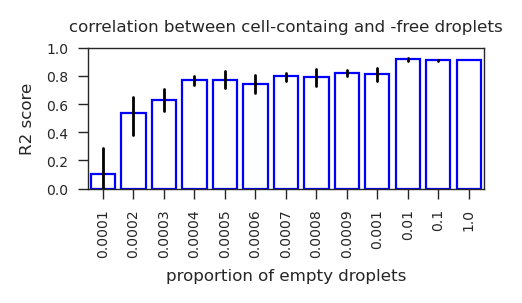

In [21]:
plt.figure(figsize=(2.5,1.5))
ax = sns.barplot(y='R2_score', x='proportion of empty droplets', data=r2_score_df, errwidth=1, linewidth=.8, facecolor=(1, 1, 1, 0),
                 errcolor="black", edgecolor="blue");
# plt.setp(ax.patches, linewidth=0.1, color='green')
ax.set_title('correlation between cell-containg and -free droplets')
ax.set_ylabel('R2 score')
ax.set_ylim([0,1]);
ax.set_xticklabels(ax.get_xticklabels(), rotation=90);
# plt.savefig('/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/figures/Fig4_CITEseq/PBMC5k_droplets_cell_correlation_fb_barplot.pdf', doi=200)

In [22]:
freq_fb = pd.DataFrame(columns=fb_raw.columns, index=['cells', 'droplets I', 'droplets II', 'droplets III', 'others'])

cell_droplets = fb_raw.loc[fb_raw.index.isin(rank_UMIs_fb[rank_UMIs_fb['droplets']=='cells'].index)].sum()
freq_fb.loc['cells']=cell_droplets/cell_droplets.sum()

droplets1 = fb_raw.loc[fb_raw.index.isin(rank_UMIs_fb[rank_UMIs_fb['droplets']=='droplets I'].index)].sum()
freq_fb.loc['droplets I']=droplets1/droplets1.sum()

droplets2 = fb_raw.loc[fb_raw.index.isin(rank_UMIs_fb[rank_UMIs_fb['droplets']=='droplets II'].index)].sum()
freq_fb.loc['droplets II']=droplets2/droplets2.sum()

droplets3 = fb_raw.loc[fb_raw.index.isin(rank_UMIs_fb[rank_UMIs_fb['droplets']=='droplets III'].index)].sum()
freq_fb.loc['droplets III']=droplets3/droplets3.sum()

droplets4 = fb_raw.loc[fb_raw.index.isin(rank_UMIs_fb[rank_UMIs_fb['droplets'].isna()].index)].sum()
freq_fb.loc['others']=droplets4/droplets4.sum()

In [23]:
dros1 = r2_score(freq_fb.T['cells'], freq_fb.T['droplets I'])
dros2 = r2_score(freq_fb.T['cells'], freq_fb.T['droplets II'])
dros3 = r2_score(freq_fb.T['cells'], freq_fb.T['droplets III'])
dros4 = r2_score(freq_fb.T['cells'], freq_fb.T['others'])

In [24]:
freq_unpivoted = freq_fb.T.melt(id_vars=['cells'], var_name='droplets', value_name='fraction of genes')
freq_unpivoted['fraction of gene counts in cells (%)'] = freq_unpivoted['cells'] * 100
freq_unpivoted['fraction of gene counts in droplets (%)'] = freq_unpivoted['fraction of genes'] * 100

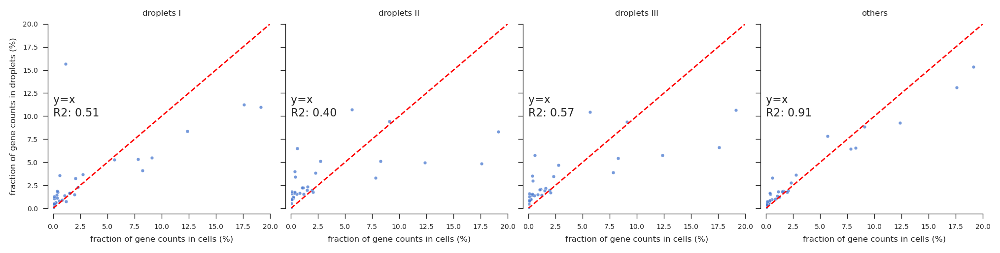

In [25]:
g = sns.relplot(data=freq_unpivoted,
                x="fraction of gene counts in cells (%)",
                y="fraction of gene counts in droplets (%)",
                col="droplets",
                # hue='droplets',
                s=6,
                alpha=0.75,
                kind="scatter",
                height=2.5,
               );

R2_dros = [dros1, dros2, dros3, dros4]
for i in range(4):
    g.axes[0,i].plot([0, 20], [0, 20], 'r--', linewidth = 1)
    g.axes[0,i].text(0, 10, f'y=x \nR2: {R2_dros[i]:.2f}', fontsize=8)
    
g.set_titles('{col_name}')
sns.set_palette("muted")
sns.set_style("ticks")
sns.despine(offset=4, trim=False);
g.set(xlim=(0,20), ylim=(0,20))
# plt.savefig('/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/figures/droplets_cell_correlation.pdf', doi=200)

In [26]:
empty_droplets = fb_raw[fb_raw.index.isin(rank_UMIs_fb[rank_UMIs_fb['droplets']=='droplets III'].index)].sum(axis=0).to_frame('empty_profile_fb')
empty_profile = empty_droplets/empty_droplets.sum()
empty_profile.to_pickle('/da/onc/bfx/research/shengca1/public_data/10xgenomics/\
5k_pbmc_protein_v3/metadata/5k_pbmc_protein_fb_empty_profile.pickle')

# fb_filtered.to_pickle('/da/onc/bfx/research/shengca1/public_data/10xgenomics/\
# 5k_pbmc_protein_v3/metadata/5k_pbmc_protein_fb_count_matrix.pickle')

Downstream Analysis
===

In [27]:
indir = "/da/onc/bfx/research/shengca1/public_data/10xgenomics/5k_pbmc_protein_v3/"
adata = sc.read_10x_mtx(indir+'/filtered_feature_bc_matrix', gex_only=False)

In [28]:
fb_filtered = adata[:,adata.var['feature_types'] == 'Antibody Capture'].to_df()
adata = adata[:,adata.var['feature_types'] == 'Gene Expression']

In [29]:
denoised_fb_filtered = pd.read_pickle('/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/CITEseq/5k_pbmc_protein_v3/scAR_out_fb/expected_natives.pickle')

In [30]:
def process_adata(adata, min_genes=200, min_counts = 1500, min_cells=3, resolution=1, random_state=8):

    adata_out = adata.copy()

    sc.pp.calculate_qc_metrics(adata_out, inplace=True)
    mito_genes = adata_out.var_names.str.startswith("MT-")
    adata_out.obs["percent_mito"] = adata_out[:,adata_out.var_names.str.startswith("MT-")].X.A.sum(axis=1) / adata_out.obs['total_counts'].values

    sc.pp.filter_genes(adata_out, min_cells=min_cells)
    
    # Filter cells by min_genes
    sc.pp.filter_cells(adata_out, min_genes=min_genes) #200
    adata_out = adata_out[adata_out.obs["n_genes_by_counts"] < 5000, :]

    # Filter cells by mitochondrial reads, n_genes, n_counts

    adata_out = adata_out[adata_out.obs["percent_mito"] < 0.2, :]
    adata_out = adata_out[adata_out.obs["total_counts"] < 15000, :]
    adata_out = adata_out[adata_out.obs["total_counts"] > min_counts, :] # 1500

    sc.pp.normalize_total(adata_out, target_sum=1e4)
    sc.pp.log1p(adata_out)  # log normalization works well for this dataset
    
    sc.pp.highly_variable_genes(adata_out, min_mean=0.02, max_mean=4, min_disp=0.5)
    sc.pp.scale(adata_out, max_value=10)
    sc.tl.pca(adata_out, svd_solver='arpack', random_state=random_state)
    sc.pp.neighbors(adata_out, n_neighbors=15, n_pcs=25, random_state=random_state)
    sc.tl.leiden(adata_out, key_added='leiden_clusters', resolution=resolution, random_state=random_state)
    sc.tl.umap(adata_out, random_state=random_state)

    return adata_out

In [31]:
adata_processed = process_adata(adata);

/da/onc/bfx/research/shengca1/tools/anaconda3/envs/cropseq/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


... storing 'feature_types' as categorical


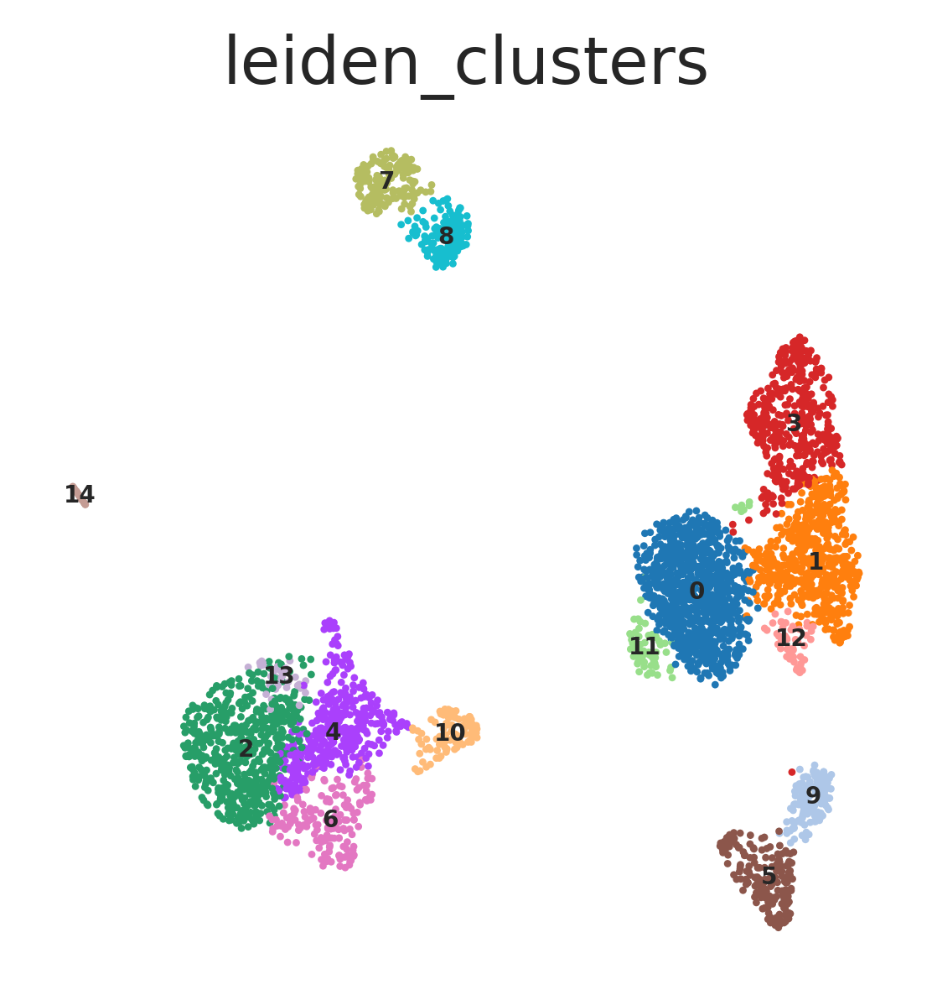

In [32]:
sc.settings.set_figure_params(dpi=200,figsize=(3, 3.2))
ax = sc.pl.umap(adata_processed, size=10, color=["leiden_clusters"],
                frameon=False,
                legend_loc="on data", legend_fontsize=5,
                vmax=3, vmin=0, return_fig=True)

In [33]:
sc.tl.rank_genes_groups(adata_processed, 'leiden_clusters', method='t-test_overestim_var')

/da/onc/bfx/research/shengca1/tools/anaconda3/envs/cropseq/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


In [34]:
result = adata_processed.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.set_option('display.max_columns', 50)
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals']}).head(20)

,0_n,0_p,1_n,1_p,2_n,2_p,3_n,3_p,4_n,4_p,5_n,5_p,6_n,6_p,7_n,7_p,8_n,8_p,9_n,9_p,10_n,10_p,11_n,11_p,12_n,12_p,13_n,13_p,14_n,14_p
0,RPL32,2.607190e-233,IL7R,4.426037e-174,S100A8,5.337718e-317,CCL5,3.030579e-201,CST3,6.794805e-131,GNLY,1.369006e-151,TYMP,3.397208e-57,CD79A,5.209252e-110,IGHM,5.539389e-147,GNLY,9.038054e-89,FCGR3A,1.686152e-73,CD8B,4.955468e-22,IL32,4.128220e-14,LYZ,4.090137e-09,IL3RA,4.003152e-31
1,RPS3A,2.956054e-236,LTB,1.237153e-108,S100A9,8.500992e-274,NKG7,2.226833e-143,CPVL,1.060535e-154,NKG7,4.426079e-96,LYZ,4.995029e-46,MS4A1,6.249861e-106,CD79A,6.683584e-128,FGFBP2,9.731910e-101,LST1,1.306790e-44,CD8A,4.200103e-19,TRBC2,4.546113e-09,S100A9,1.400220e-09,ITM2C,1.099308e-36
2,RPL30,1.403887e-223,IL32,4.036431e-101,VCAN,1.676195e-271,GZMA,4.664574e-112,LYZ,2.416673e-120,KLRD1,4.288561e-111,FCN1,4.195122e-46,HLA-DQA1,1.247431e-103,CD79B,4.778632e-109,GZMH,1.631383e-94,SMIM25,2.895226e-49,LINC02446,7.528844e-13,TRAC,1.587820e-08,S100A8,2.769292e-09,CCDC50,2.241606e-34
3,RPL13,1.332002e-212,TRAC,9.301947e-81,MNDA,3.072747e-245,CST7,4.002676e-108,FGL2,4.694079e-122,KLRF1,3.507595e-103,MNDA,2.335360e-48,BANK1,6.530859e-86,IGHD,9.633456e-73,KLRC2,1.546400e-78,TCF7L2,5.283703e-45,LDHB,1.915490e-10,DUSP4,2.066305e-07,FCN1,4.510969e-08,PLD4,2.352579e-28
4,RPL11,4.927759e-218,CD2,2.970675e-61,S100A12,7.955339e-278,IL32,1.624115e-93,FCN1,8.040363e-117,PRF1,5.137376e-103,CTSS,1.367636e-43,CD79B,7.372890e-78,HLA-DQA1,5.518611e-90,PRF1,6.082340e-89,LYN,4.807672e-47,RPS5,5.839428e-09,PBXIP1,2.296463e-07,MNDA,6.314553e-08,IRF8,2.219545e-29
5,RPL9,3.048113e-212,AQP3,3.889710e-56,LYZ,6.439167e-210,GZMM,1.971892e-82,AIF1,2.325613e-111,CTSW,2.215045e-100,CST3,8.360337e-44,HLA-DQB1,2.856996e-68,MS4A1,2.593592e-87,CST7,1.657700e-78,MS4A7,3.145345e-51,RPS12,8.137860e-09,TIGIT,9.511557e-07,CD14,4.874796e-08,TCF4,2.298576e-28
6,RPS12,4.610623e-206,CD3E,9.977722e-55,FCN1,8.260205e-216,CD3D,2.843489e-78,HLA-DRA,3.705970e-112,GZMA,4.899002e-91,FGL2,9.682224e-49,CD37,4.291135e-56,TCL1A,2.588488e-64,NKG7,6.674677e-67,FCER1G,2.207851e-38,NPM1,1.279301e-08,TTN,1.289066e-06,VCAN,1.056148e-07,MZB1,7.086212e-23
7,RPS6,1.710223e-209,RPS18,1.448445e-52,CTSS,2.340158e-184,KLRG1,8.529854e-76,KLF4,2.051907e-122,GZMB,7.074528e-89,PSAP,4.206572e-43,RALGPS2,9.599910e-54,CD37,7.586777e-68,GZMB,1.854582e-88,CDKN1C,1.793346e-38,RPS4X,1.540500e-08,MALAT1,6.055542e-07,CTSS,3.207630e-07,UGCG,1.970536e-26
8,RPL34,5.442969e-207,RPL14,4.420945e-48,CD14,3.373562e-225,B2M,3.333393e-73,PSAP,7.972252e-111,CLIC3,9.548961e-76,S100A9,8.819854e-45,HLA-DPB1,2.894390e-50,HLA-DPB1,9.460228e-48,CCL5,6.843862e-62,LRRC25,1.204359e-45,CD3E,2.135552e-08,ISG20,6.727891e-07,TYMP,4.104099e-07,IRF7,3.637401e-27
9,TPT1,6.016059e-210,CD3D,2.352046e-47,CSF3R,1.138114e-215,LYAR,4.581362e-59,HLA-DRB1,1.798687e-110,HOPX,2.656793e-83,CD14,6.401745e-50,HLA-DRA,1.080202e-44,CD74,5.936858e-44,FCGR3A,7.623944e-75,CFD,1.647481e-41,CRTAM,3.343375e-08,IKZF2,1.863312e-06,CST3,8.628783e-07,JCHAIN,3.318147e-22


In [35]:
new_cluster_names = {
    "11": "CD8+ naïve T","0": "CD4+ naïve T",
    "12": "Treg","1": "CD4+ memory T","3": "CD8+ memory T",
    "9": "memory-like NK","5": "NK",
    "7": "mature B","8": "pre-B",
    "2": "CD14 mono", "13": "intermediate mono", "4": "intermediate mono", "6": "intermediate mono", "10": "CD16 mono",
    "14": "pDC",
}

adata_processed.obs['celltype_1'] = adata_processed.obs.leiden_clusters.astype("str").values
adata_processed.obs.celltype_1 = adata_processed.obs.celltype_1.replace(new_cluster_names)
adata_processed.obs.celltype_1 = adata_processed.obs.celltype_1.astype("category")
adata_processed.obs.celltype_1.cat.reorder_categories([
    'CD4+ naïve T', 'CD4+ memory T', 'Treg',
    'CD8+ naïve T', 'CD8+ memory T', 'NK', 'memory-like NK',
    'pre-B', 'mature B',
    'CD14 mono', 'intermediate mono', 'CD16 mono',
    'pDC'], inplace=True)

/da/onc/bfx/research/shengca1/tools/anaconda3/envs/cropseq/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2630: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  res = method(*args, **kwargs)


In [36]:
celltype_dict = {'CD4+ naïve T': 'T cells', 
                 'CD4+ memory T': 'T cells', 
                 'Treg': 'T cells',
                 'CD8+ naïve T': 'T cells',
                 'CD8+ memory T': 'T cells',
                 'NK': 'NK cells', 
                 'memory-like NK': 'NK cells',
                 'pre-B': 'B cells',
                 'mature B': 'B cells',
                 'CD14 mono': 'Monocytes', 
                 'intermediate mono': 'Monocytes', 
                 'CD16 mono': 'Monocytes',
                 'pDC': 'Dendritic'
                }

adata_processed.obs['celltype'] = adata_processed.obs['celltype_1'].map(celltype_dict)
adata_processed.obs.celltype = adata_processed.obs.celltype.astype('category')
adata_processed.obs.celltype.cat.reorder_categories(['T cells',  'NK cells',  'B cells', 'Monocytes', 'Dendritic'], inplace=True)

/da/onc/bfx/research/shengca1/tools/anaconda3/envs/cropseq/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2630: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  res = method(*args, **kwargs)


/da/onc/bfx/research/shengca1/tools/anaconda3/envs/cropseq/lib/python3.8/site-packages/IPython/core/pylabtools.py:137: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


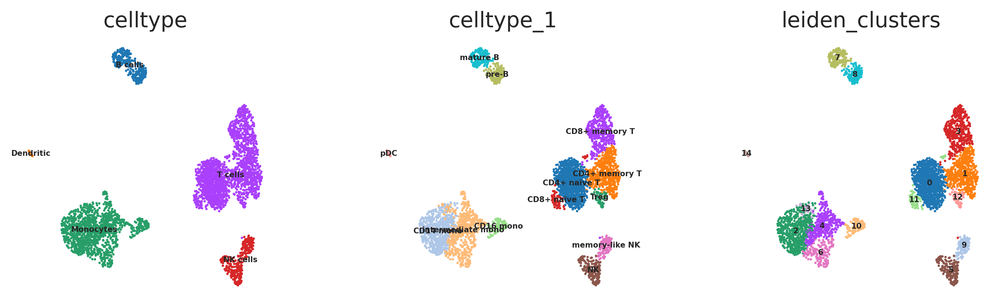

In [37]:
sc.settings.set_figure_params(dpi=150,figsize=(3, 3.1))
sc.pl.umap(adata_processed, size=10,color=["celltype", "celltype_1", "leiden_clusters"],color_map="viridis",legend_loc="on data", frameon=False, legend_fontsize=5) #legend_loc="right margin", 

In [38]:
marker_genes = ['IL7R', 'TRAC',
                'ITGB1', #'CD29', 
                'FOXP3', 'IL2RA',
                'CD8A', 'CD8B', 'CCL5',
                'GNLY', 'NKG7', 'KLRC2',
                'CD79A', 'MS4A1', 'TCL1A', 'IGHM', 'IGHD',
                'IL4R', 'TCL1A',
                'KLF4', 'LYZ', 'S100A8', 'ITGAM', # CD11b
                'CD14', 'FCGR3A', 'MS4A7',
                'CST3', 'IRF8', 'TCF4']

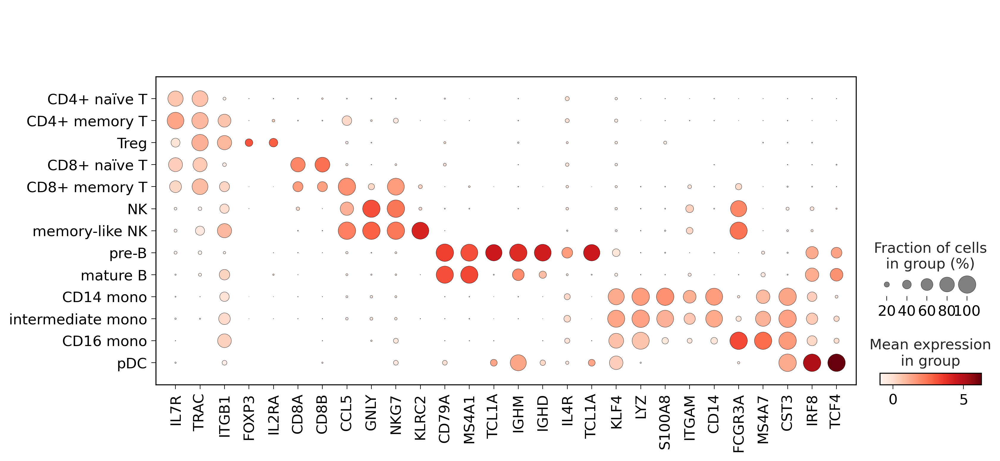

In [39]:
sc.pl.dotplot(adata_processed, marker_genes, groupby='celltype_1');

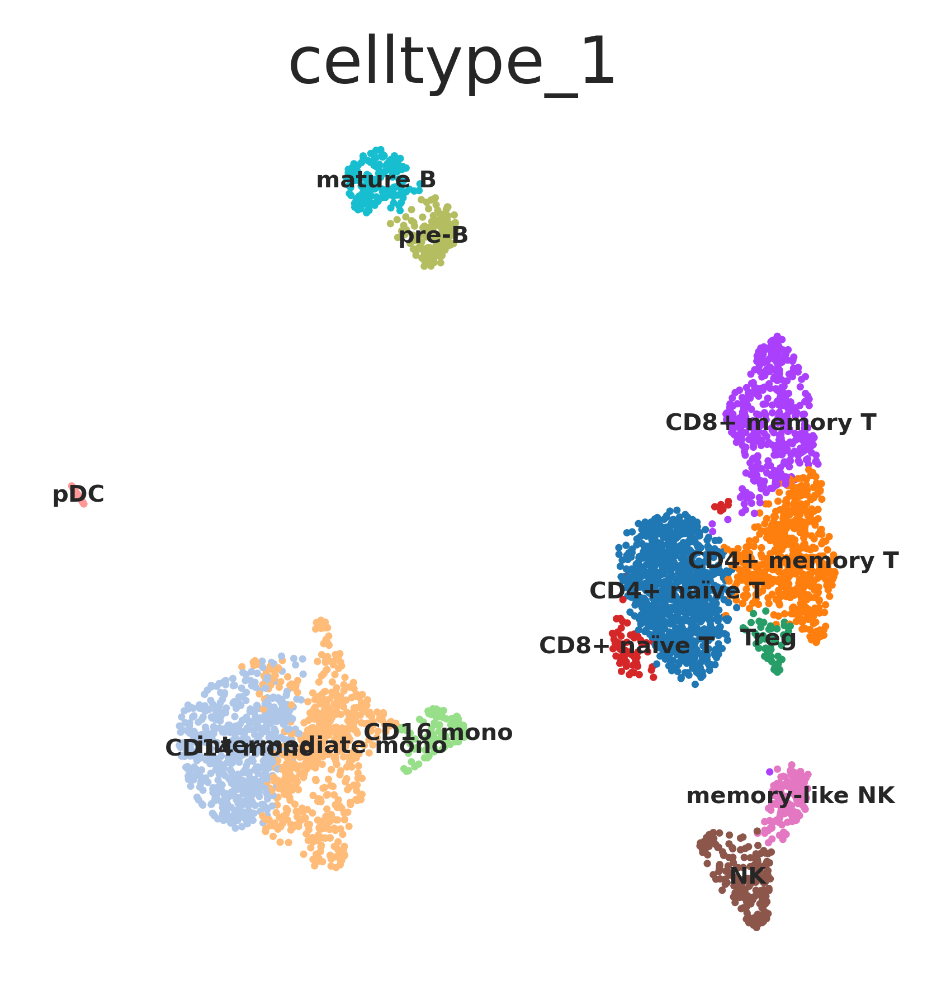

In [40]:
sc.settings.set_figure_params(dpi=300,figsize=(3, 3.2))
ax = sc.pl.umap(adata_processed, size=10, color=["celltype_1"],
                frameon=False,
                legend_loc="on data", legend_fontsize=5,
                vmax=3, vmin=0,  save='CITEseq_5k_PBMCs_protein_celltype.pdf', return_fig=False) #legend_loc="right margin",vcenter=0.5,

In [41]:
marker_genes_dict = {"T cells": [ "CD3E", "CD2", "TRAC","CCL5"],   #"IL4R",
                     "CD4 T Cells": ["IL7R","CD4"],
                     "CD8 T Cells": ["CD8B"],
                     "NK": ['GZMB','GZMA','GZMH', "GNLY", "NKG7", "KLRB1"], #"CD2", "CD3D",
                     "B cells": ["MS4A1","CD79A"], #, "CD37"
                    "CD14 Monocytes": ["CD14", "LYZ"],
                    'Monocytes': ['FCGR3A','CD14',"FCN1", "SELL"], #"CD68","HLA-DRB5", 'LYZ','HLA-DMA','S100A4',"SELL", "HLA-DRA","HLA-DRB1"],LYZ, S100A8, CD14, S100A10, HLA-DRA, CD74, IFI30, HLA-DPB1, CPV
                    "CD16 Monocytes": ["FCGR3A"],
                    "Dendritic": ["FCER1A"],#, "CST3"
                    # "precursors": ["TPSB2","TPSAB1","CPA3"]
                     }

In [42]:
marker_list = []
for ct, mg in marker_genes_dict.items():
    if type(mg) is str:
        mg = [mg]
    marker_list.extend(mg)

/da/onc/bfx/research/shengca1/tools/anaconda3/envs/cropseq/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2630: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


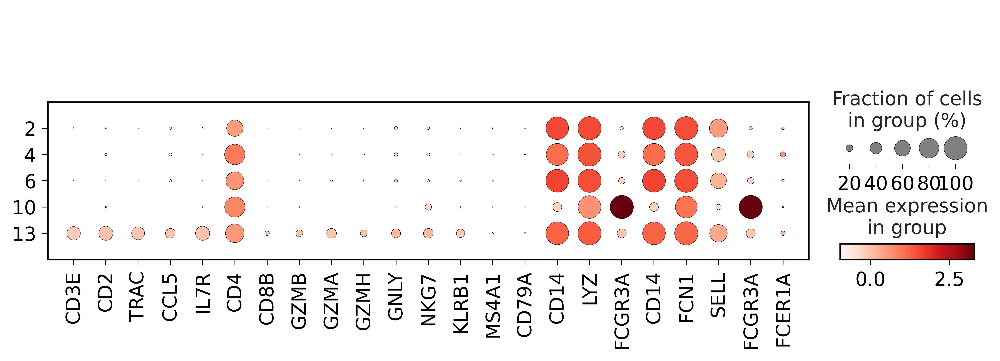

In [43]:
sc.pl.dotplot(adata_processed[adata_processed.obs['celltype']=='Monocytes'], marker_list, groupby='leiden_clusters');

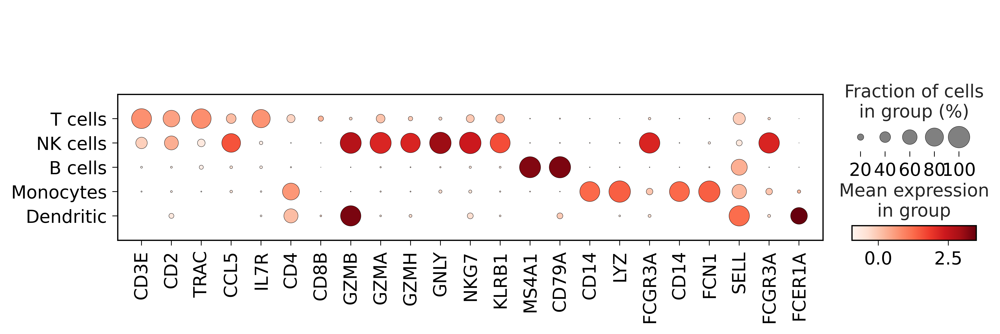

In [44]:
sc.pl.dotplot(adata_processed, marker_list, groupby='celltype');

In [45]:
fb_filtered.columns = fb_filtered.columns.str.replace('_TotalSeqB', '_raw')
denoised_fb_filtered.columns = denoised_fb_filtered.columns.str.replace('_TotalSeqB', '_scar')

fb_filtered1 = np.log2(fb_filtered+1)
denoised_fb_filtered1 = np.log2(denoised_fb_filtered+1)

In [46]:
mRNA_list = {'CD86': 'CD86',
            'CD274': 'CD274',
            'CD8a': 'CD8A',
            'CD56': 'CD56',
            'CD19': 'CD19',
            'CD45RA': 'PTPRC',
            'CD4': 'CD4',
            'CD14': 'CD14',
            'CD16': 'FCGR3A',
            'CD25': 'IL2RA',
            'CD45RO': 'PTPRC',
            'TIGIT': 'TIGIT',
            'CD20': 'MS4A1',
            'CD335': 'NCR1',
            'CD69': 'CD69',
            'CD62L': 'SELL',
             'CD197': 'CCR7',
            'CD27': 'CD27',
            'HLA-DR': 'HLA-DRA',
            'CD278': 'ICOS',
            'CD137': 'TNFRSF9',
            'CD28': 'CD28',
            'CD127': 'IL7R',
            'CD86': 'CD86',
            'CD274': 'CD274',
            'CD3': 'CD3D',
            'CD56': 'NCAM1',
            'CD19': 'CD19',
            'CD11b': 'ITGAM',
            'CD15': 'FUT4',
            'CD20': 'CCR7',
            'CD34': 'CD34',
            'CD80': 'CD80',
            'PD-1': 'PDCD1',
            'IgG1_control': 'IGHG1',
            'IgG2a_control': 'IGHG2',
            'IgG2b_control': 'IGHG2',
            }

for key in fb_filtered.columns.str.replace('_raw', ''):
    mRNA_list[key] = mRNA_list.pop(key)

In [47]:
for gene in set(mRNA_list.values()):
    if (gene in adata.var_names) and (gene not in adata_processed.var_names):
        print(gene, ' filtered out')
    if (gene not in adata.var_names) and (gene not in adata_processed.var_names):
        print(gene, ' wrong name')

In [48]:
adata_tmp = adata.copy()
sc.pp.normalize_total(adata_tmp, target_sum=1e4)
mRNA = adata_tmp[:, list(set(mRNA_list.values()))][adata_processed.obs.index].to_df()

In [49]:
mRNA = np.log2(mRNA + 1)
adata_processed.obs = adata_processed.obs.join(mRNA, how ='left').join(fb_filtered1, how='left').join(denoised_fb_filtered1, how='left')

In [50]:
sorted_idx = adata_processed.obs.sort_values('celltype_1').index
adata_processed = adata_processed[sorted_idx]

In [51]:
adata_processed.write('/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/data/CITEseq_5k_PBMCs/processed_adata_20_11_2021.h5ad')

In [52]:
adata_processed = sc.read('/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/data/CITEseq_5k_PBMCs/processed_adata_20_11_2021.h5ad')

## Heatmap

In [53]:
sorted_idx = adata_processed.obs.sort_values('celltype_1').index
mRNA_name = denoised_fb_filtered1.columns.str.replace('_scar', '').map(mRNA_list)

In [54]:
import collections
celltype_name = pd.DataFrame(collections.Counter(adata_processed.obs.loc[sorted_idx,'celltype_1']),index=[0])
celltype_name = celltype_name[np.unique(adata_processed.obs.celltype_1)][adata_processed.obs.loc[sorted_idx, 'celltype_1'].unique()]#[::-1]

In [55]:
tmp = denoised_fb_filtered1.loc[sorted_idx].copy()
tmp.columns = tmp.columns.str.replace('_scar', '')
ct1 = adata_processed.obs.sort_values('celltype_1')

In [56]:
import matplotlib.colors
color_palette = dict(zip(adata_processed.obs.celltype_1.cat.categories, adata_processed.uns['celltype_1_colors']))
row_colors = ct1['celltype_1'].map(color_palette)
row_colors = [matplotlib.colors.to_rgb(c) for c in row_colors]

In [57]:
mean_exp_by_celltype = adata_processed.obs.groupby('celltype_1').mean()
row_colors = mean_exp_by_celltype.index.map(color_palette)
row_colors = [matplotlib.colors.to_rgb(c) for c in row_colors]

In [58]:
markers = ['CD3', 'CD4', 'CD27', 'CD28', 'PD-1', 'CD62L', 'CD25', 'CD127', 'CD20', 'CD278','CD8a',  'CD137',  'CD274',  'CD69', 'CD80', 'CD56', 'CD335', 'CD16',
            'TIGIT', 'CD19', 'CD20', 'HLA-DR', 'CD11b', 'CD86', 'CD14', 'CD45RA', 'CD45RO',  'CD15',  'CD34', 'IgG1_control', 'IgG2a_control',
       'IgG2b_control']

In [59]:
plot_setting()

<Figure size 600x400 with 0 Axes>

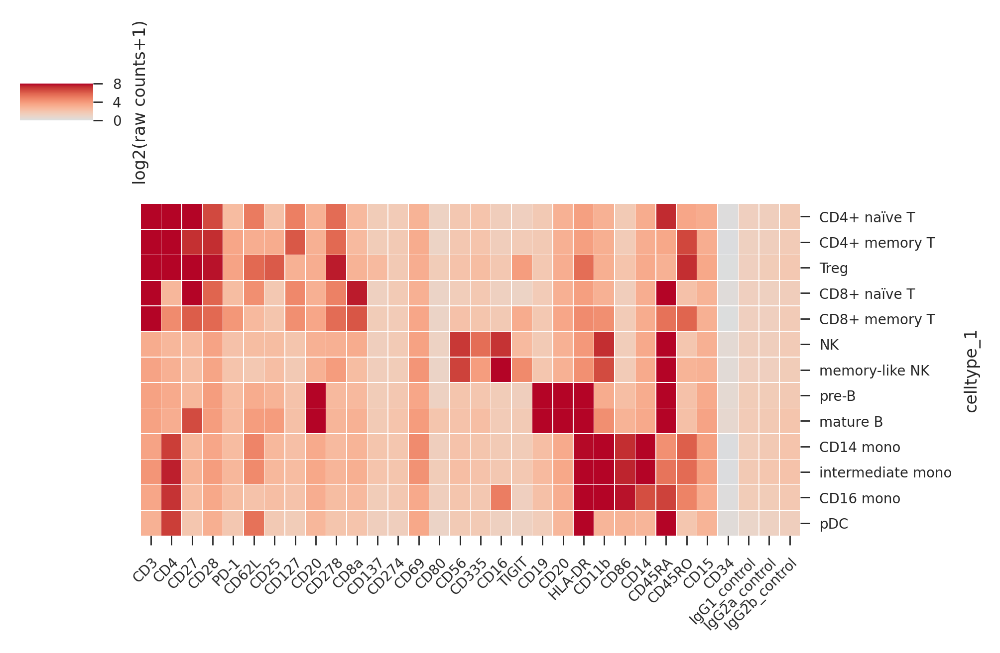

In [60]:
tmp = mean_exp_by_celltype[fb_filtered1.columns].copy()
tmp.columns = tmp.columns.str.replace('_raw', '')
tmp=tmp[markers]

cbar_kws = {"shrink": 1,
            'ticks': [0, 4, 8], # set ticks of color bar
            'label':'log2(raw counts+1)',
           }

g = sns.clustermap(tmp,
                   # row_colors=row_colors,
                   row_cluster=False,
                   col_cluster=False,
                   figsize=(5, 3),
                   cmap="coolwarm", vmin=0, vmax=8, center=0.1,
                   dendrogram_ratio=0.1,
                   cbar_pos=(0.02, 0.8, 0.05, 0.18), yticklabels=1,
                   cbar_kws = cbar_kws,
                   linewidths=.1
                  )

g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xmajorticklabels(), fontsize=5, rotation=45, ha="right",
         rotation_mode="anchor");

# plt.savefig('/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/figures/Fig4_CITEseq_back/heatmap_raw_counts_20.11.2021.pdf')

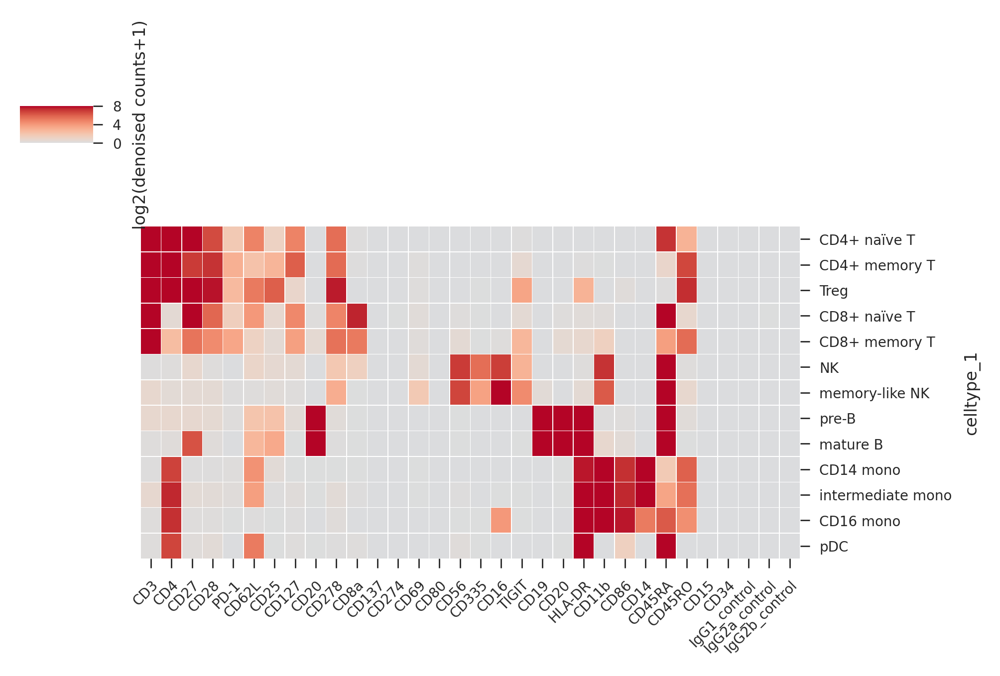

In [61]:
tmp = mean_exp_by_celltype[denoised_fb_filtered1.columns].copy()
tmp.columns = tmp.columns.str.replace('_scar', '')
tmp=tmp[markers]

cbar_kws = {"shrink": 1,
            'ticks': [0, 4, 8], # set ticks of color bar
            'label':'log2(denoised counts+1)',
           }

g = sns.clustermap(tmp,
                   # row_colors=row_colors,
                   row_cluster=False,
                   col_cluster=False,
                   figsize=(5, 3),
                   cmap="coolwarm", vmin=0, vmax=8, center=0.1,
                   dendrogram_ratio=0.1,
                   cbar_pos=(0.02, 0.8, 0.05, 0.18),
                   cbar_kws = cbar_kws,
                   yticklabels=1,
                   linewidths=.1
                  )
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xmajorticklabels(), fontsize=5, rotation=45, ha="right",
         rotation_mode="anchor");
# plt.savefig('/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/figures/Fig4_CITEseq_back/heatmap_denoised_counts_20.11.2021.pdf')

In [62]:
mean_exp_by_celltype = mean_exp_by_celltype.loc[:,~mean_exp_by_celltype.columns.duplicated()]

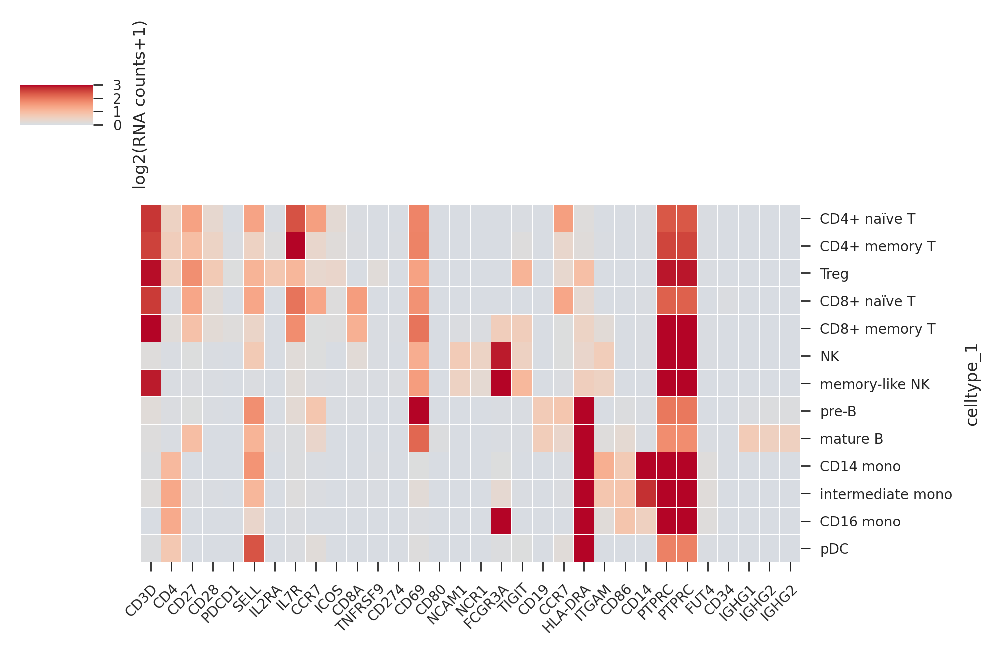

In [63]:
cbar_kws = {"shrink": 1,
            'ticks': [0, 1, 2, 3], # set ticks of color bar
            'label':'log2(RNA counts+1)'}
g = sns.clustermap(mean_exp_by_celltype[[mRNA_list[mrk] for mrk in markers]].copy(),
                   # row_colors=row_colors,
                   row_cluster=False,
                   col_cluster=False,
                   figsize=(5, 3),
                   cmap="coolwarm", vmin=0, vmax=3, center=0.1,
                   dendrogram_ratio=0.1,
                   cbar_pos=(0.02, 0.8, 0.05, 0.18),
                   yticklabels=1,
                   cbar_kws = cbar_kws,
                   linewidths=.1
                  )
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xmajorticklabels(), fontsize=5, rotation=45, ha="right", rotation_mode="anchor");
# plt.savefig('/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/figures/Fig4_CITEseq_back/heatmap_mRNA_counts_20_11_2021.pdf')

## barplot by celltype

In [64]:
color_denoised = sns.color_palette("Paired", 8)
color_denoised

[(0.6509803921568628, 0.807843137254902, 0.8901960784313725),
 (0.12156862745098039, 0.47058823529411764, 0.7058823529411765),
 (0.6980392156862745, 0.8745098039215686, 0.5411764705882353),
 (0.2, 0.6274509803921569, 0.17254901960784313),
 (0.984313725490196, 0.6039215686274509, 0.6),
 (0.8901960784313725, 0.10196078431372549, 0.10980392156862745),
 (0.9921568627450981, 0.7490196078431373, 0.43529411764705883),
 (1.0, 0.4980392156862745, 0.0)]

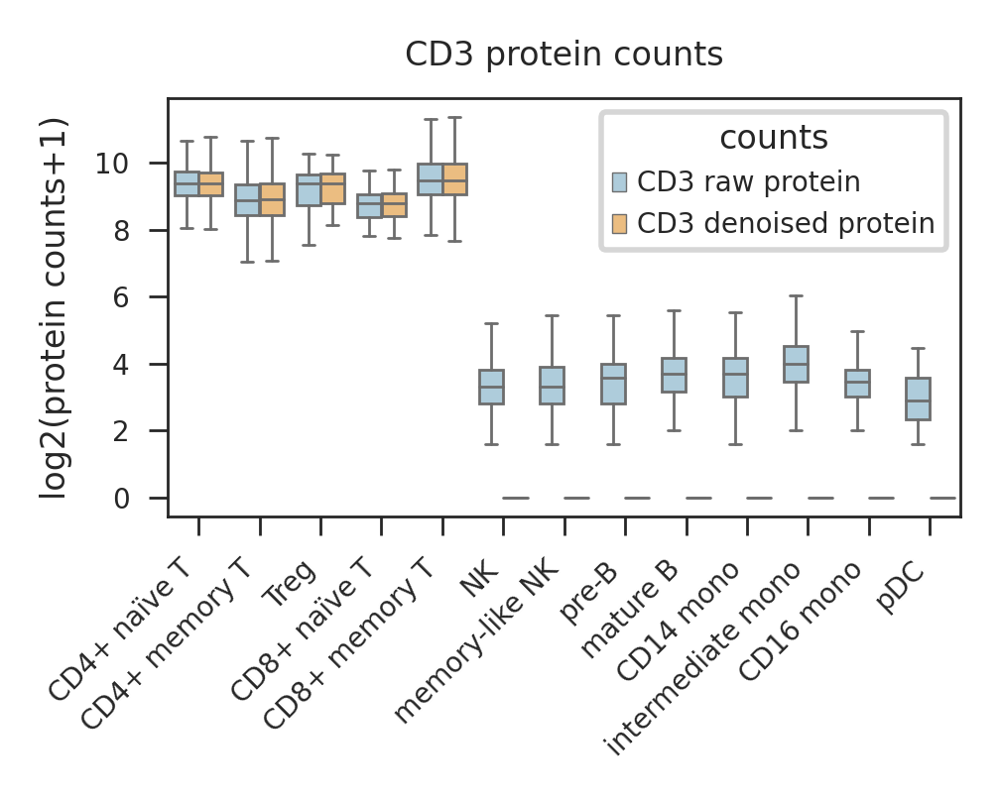

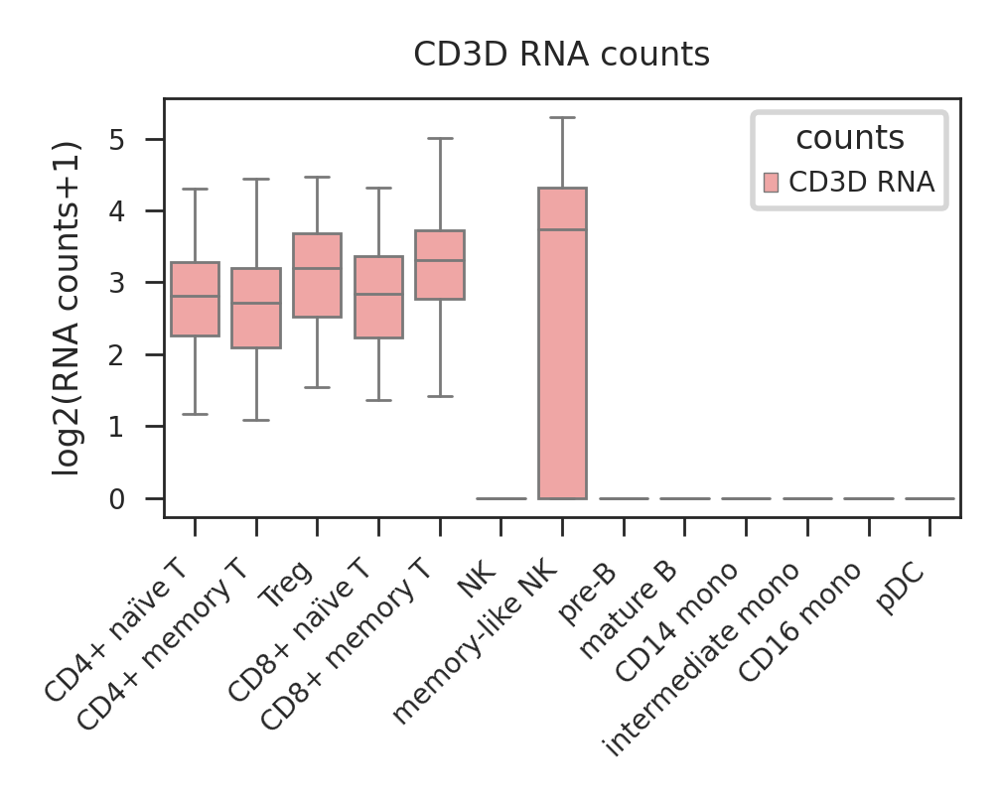

In [65]:
for marker in mRNA_list.keys():
    
    gname = mRNA_list[marker]
    tmp = adata_processed.obs[['celltype_1', f'{marker}_raw', f'{marker}_scar', gname]]
    tmp.columns = tmp.columns.str.replace('_raw', ' raw protein').str.replace('_scar', ' denoised protein')
    tmp = tmp.rename(columns={ gname: gname+' RNA'})
    tmp = tmp.melt(id_vars=['celltype_1'], var_name='counts', value_name='log2 (counts+1)')
    tmp['antibody'] = marker
    
    plt.figure(figsize=(2.5, 2))
    g = sns.boxplot(y="log2 (counts+1)",x="celltype_1",
                hue="counts", hue_order=[f'{marker} raw protein', f'{marker} denoised protein'],
                data=tmp,
                orient="v", palette=[color_denoised[0], color_denoised[-2]], #height=2, aspect=0.75, 
                dodge=True,
                width=0.8, showfliers=False, linewidth=0.5,
               );
    g.set(xlabel='', ylabel='log2(protein counts+1)', title=f'{marker} protein counts');
    g.set_xticklabels(g.get_xticklabels(),rotation=45, ha='right')
    # g.figure.savefig(f'/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/figures/Fig4_CITEseq_back/{marker}_protein_barplots.pdf')
    
    plt.figure(figsize=(2.5, 2))
    g_RNA = sns.boxplot(y="log2 (counts+1)",x="celltype_1",
                hue="counts", hue_order=[f'{gname} RNA'],
                data=tmp,
                orient="v", palette=[color_denoised[4]], #height=2, aspect=0.75, 
                dodge=True,
                width=0.8, showfliers=False, linewidth=0.5,
               );
    g_RNA.set(xlabel='', ylabel='log2(RNA counts+1)', title=f'{gname} RNA counts');
    g_RNA.set_xticklabels(g.get_xticklabels(),rotation=45, ha='right')
    
    break
    # g_RNA.figure.savefig(f'/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/figures/Fig4_CITEseq_back/{marker}_RNA_barplots.pdf')

## noise ratio

In [66]:
noise = pd.read_pickle('/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/CITEseq/5k_pbmc_protein_v3/scAR_out_fb/expected_noise_ratio.pickle')
noise['total_protein'] = fb_filtered.sum(axis=1)
# noise['total_noise'] = noise['expected_noise_ratio']*noise['total_protein']
noise = noise.join(adata_processed.obs[["celltype_1"]], how='right') #noise_mRNA['total_noise'] = noise_mRNA['total_noise']/noise_mRNA['total_counts']

In [67]:
noise = noise.melt(id_vars='celltype_1')

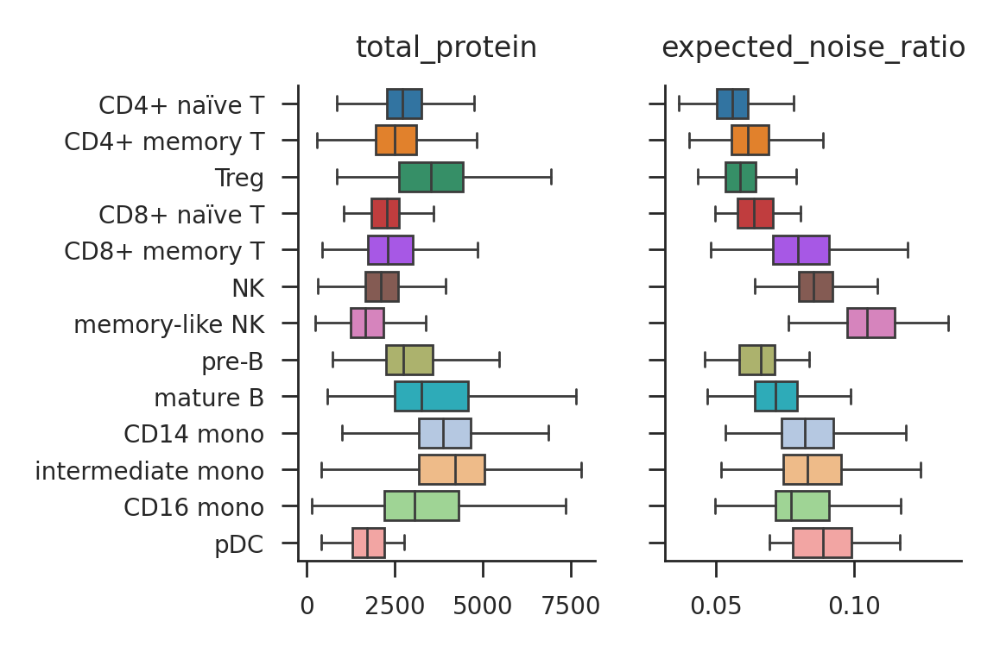

In [68]:
g = sns.catplot(y="celltype_1",x="value",
                col="variable", col_order=['total_protein', 'expected_noise_ratio'],
                data=noise,
                orient="h", height=2, aspect=0.75, palette=color_palette,
                kind="box", dodge=True, 
                width=0.8, showfliers=False, linewidth=0.5,
                sharex=False,);
g.set(xlabel='', ylabel='');
g.set_titles('{col_name}');
# plt.savefig('/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/figures/Fig4_CITEseq_back/noise_ratio_21_11_2021.pdf')

In [69]:
noise_mRNA = pd.read_pickle('/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/CITEseq/5k_pbmc_protein_v3/scAR_out_mRNA/expected_noise_ratio.pickle')
noise_mRNA = noise_mRNA.join(adata_processed.obs, how='right')

In [70]:
noise_mRNA['total_noise'] = noise_mRNA['expected_noise_ratio'] * noise_mRNA['total_counts']
noise_mRNA = noise_mRNA[['expected_noise_ratio', 'total_counts', 'total_noise', 'celltype_1']].melt(id_vars='celltype_1')

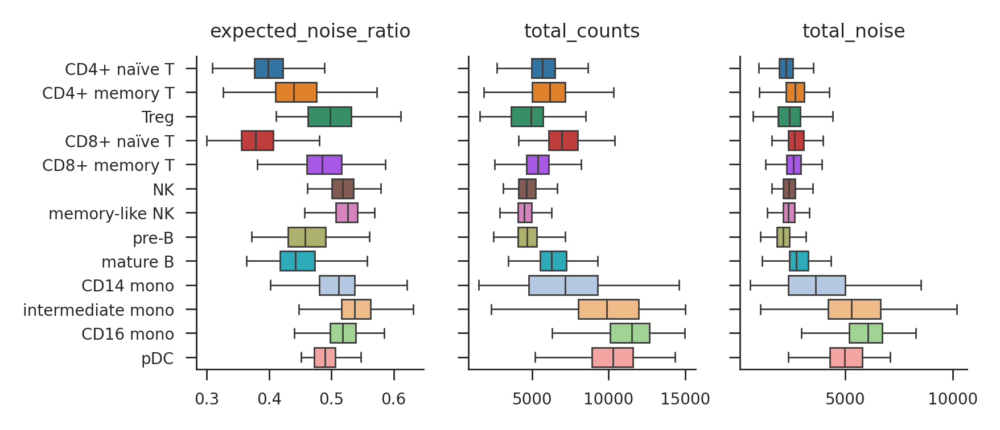

In [71]:
g = sns.catplot(y="celltype_1",x="value",
                col="variable",
                data=noise_mRNA,
                orient="h", height=2, aspect=0.75, palette=color_palette,
                kind="box", dodge=True, 
                width=0.8, showfliers=False, linewidth=0.5,
                sharex=False,);
g.set(xlabel='', ylabel='');
g.set_titles('{col_name}');

## PD-1 displot

In [72]:
marker = 'PD-1'
gname = mRNA_list[marker]
tmp = adata_processed.obs[['celltype','celltype_1', f'{marker}_raw', f'{marker}_scar', gname]]
tmp.columns = tmp.columns.str.replace('_raw', ' raw protein').str.replace('_scar', ' denoised protein')
tmp = tmp.rename(columns={ gname: gname+' RNA'})
tmp = tmp.melt(id_vars=['celltype', 'celltype_1'], var_name='counts', value_name='log2 (counts+1)')
tmp['antibody'] = marker

In [73]:
tmp['celltype'] = tmp['celltype'].cat.add_categories(['naïve T'])
tmp['celltype'] = tmp['celltype'].mask(tmp['celltype_1'].str.contains('naïve'), 'naïve T')
tmp['celltype'] = tmp['celltype'].cat.rename_categories({'T cells': 'other T cells'})

Text(0.5, 1.0, 'denoised PD-1 counts')

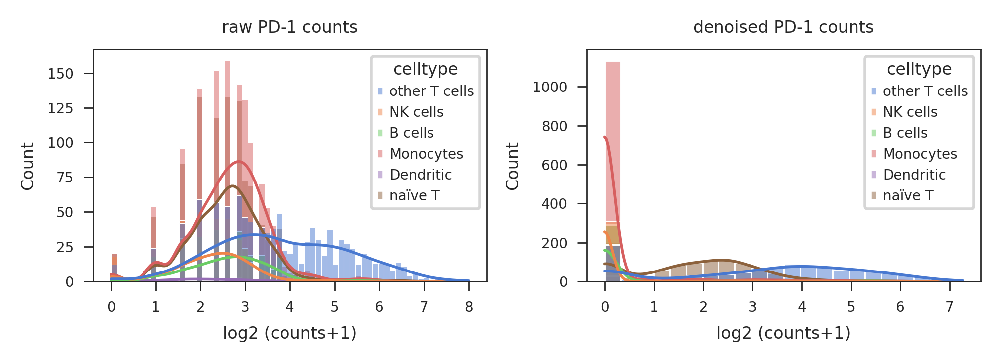

In [74]:
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(5,1.8))
sns.histplot(data=tmp[tmp['counts'].str.contains('raw')], x="log2 (counts+1)", hue='celltype', kde=True, line_kws={"linewidth":1}, ax=axs[0]);
axs[0].set_title('raw PD-1 counts')
sns.histplot(data=tmp[tmp['counts'].str.contains('denoised')], x="log2 (counts+1)", hue='celltype', kde=True, line_kws={"linewidth":1}, ax=axs[1]);
axs[1].set_title('denoised PD-1 counts')
# fig.savefig(f'/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/figures/Fig4_CITEseq_back/PD-1_background.pdf')

In [75]:
marker = 'CD3'
gname = mRNA_list[marker]
tmp = adata_processed.obs[['celltype','celltype_1', f'{marker}_raw', f'{marker}_scar', gname]]
tmp.columns = tmp.columns.str.replace('_raw', ' raw protein').str.replace('_scar', ' denoised protein')
tmp = tmp.rename(columns={ gname: gname+' RNA'})
tmp = tmp.melt(id_vars=['celltype', 'celltype_1'], var_name='counts', value_name='log2 (counts+1)')
tmp['antibody'] = marker

In [76]:
np.mean(np.exp2(tmp[(tmp['counts']=='CD3 raw protein') & (tmp['celltype']!='T cells')]['log2 (counts+1)'])-1)

36.22380828857422

## UMAP

In [77]:
sorted_columns = []
tmp = adata_processed.copy()
vmax_list = []

for k,v in mRNA_list.items():
    if k in ['CD11b', 'PD-1', 'CD15']:
        sorted_columns += [k+'_raw', k+'_scar', v+'_RNA']
        vmax_list += [10, 10, 3]
        tmp.obs.rename(columns={v: v+'_RNA'}, inplace=True)

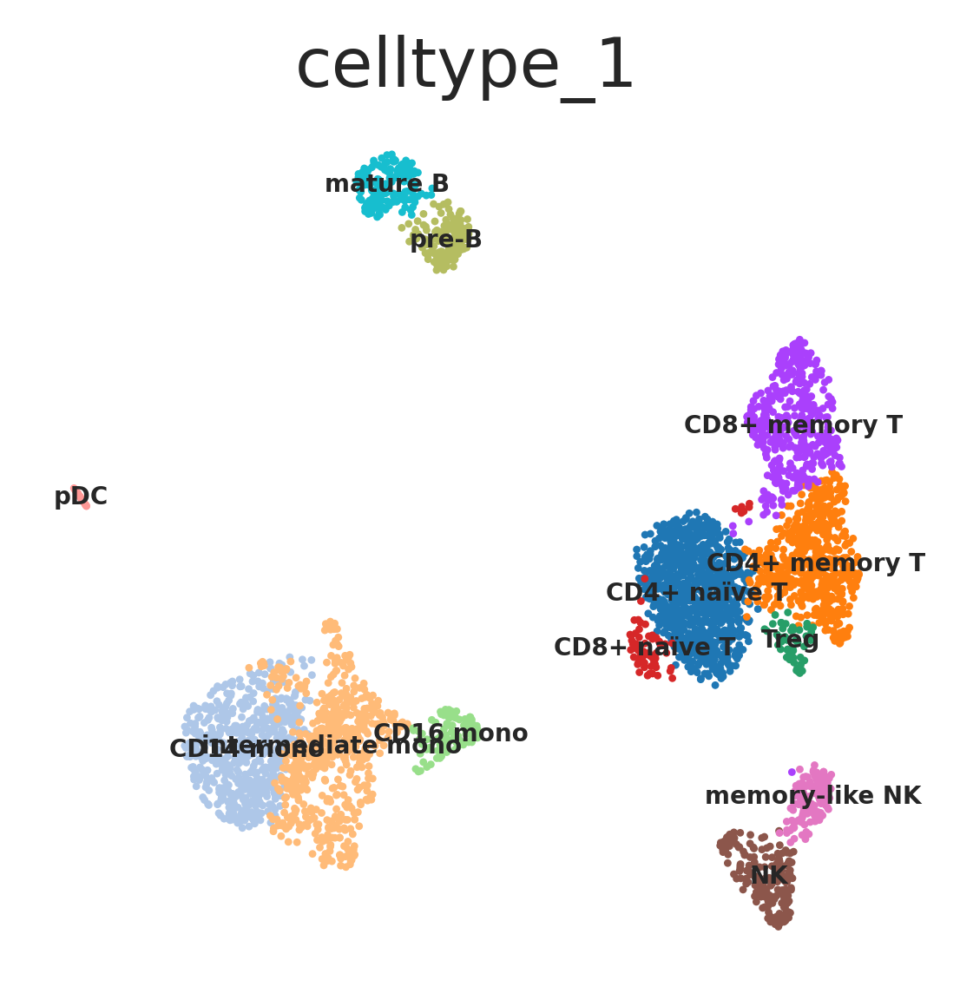

In [78]:
color_palette = dict(zip(adata_processed.obs['celltype_1'].cat.categories, adata_processed.uns['celltype_1_colors']))

sc.settings.set_figure_params(dpi=200,figsize=(3, 3.1))
ax = sc.pl.umap(tmp, size=10, color=["celltype_1"],
           palette=color_palette,
           frameon=False,
           legend_loc="on data", legend_fontsize=5,
           vmax=3, vmin=0,  save='CITEseq_5k_PBMCs_protein_celltype.pdf', return_fig=True) #legend_loc="right margin",vcenter=0.5,

In [79]:
# adata_processed = sc.read('/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/data/CITEseq_5k_PBMCs/processed_adata_20_11_2021.h5ad')

sorted_columns = []
tmp = adata_processed.copy()
vmax_list = []
tmp.obs.columns = tmp.obs.columns.str.replace('_raw', ' raw protein').str.replace('_scar', ' denoised protein')
for k,v in mRNA_list.items():
        sorted_columns += [k+' raw protein', k+' denoised protein', v+' RNA']
        vmax_list += [8, 8, 3]
        tmp.obs.rename(columns={v: v+' RNA'}, inplace=True)

### UMAP CD11b

/da/onc/bfx/research/shengca1/tools/anaconda3/envs/cropseq/lib/python3.8/site-packages/scanpy/plotting/_utils.py:288: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pl.savefig(filename, dpi=dpi, bbox_inches='tight')
/da/onc/bfx/research/shengca1/tools/anaconda3/envs/cropseq/lib/python3.8/site-packages/IPython/core/pylabtools.py:137: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


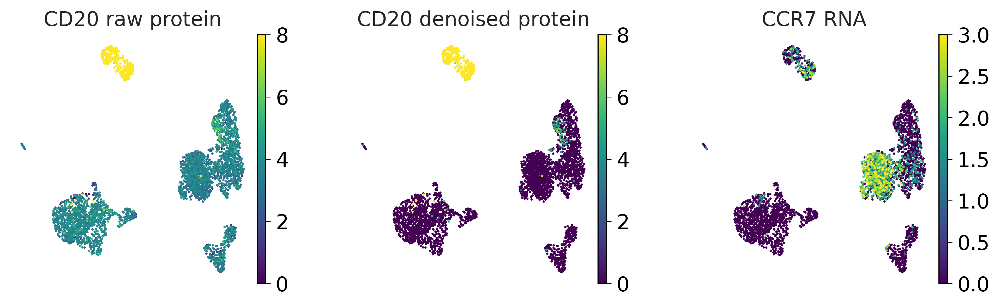

In [80]:
sc.settings.set_figure_params(dpi=200,figsize=(3, 3.1))
sc.pl.umap(tmp, size=10, color=["CD20 raw protein", "CD20 denoised protein", 'CCR7 RNA'],
           color_map="viridis",
           frameon=False,
           legend_loc="on data", legend_fontsize=5,
           vmax=[8, 8, 3], vmin=0, save='CITEseq_5k_PBMCs_CD20_protein_RNA.pdf') #legend_loc="right margin", #vcenter=1, 

### UMAP PD-1

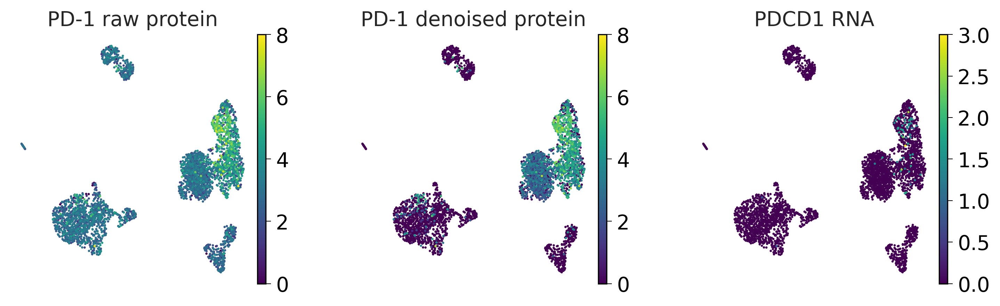

In [81]:
sc.settings.set_figure_params(dpi=150,figsize=(3, 3.1))
sc.pl.umap(tmp, size=10, color=["PD-1 raw protein", "PD-1 denoised protein", "PDCD1 RNA"],
           palette=None, color_map="viridis",
           frameon=False,
           legend_loc="on data", legend_fontsize=5,
           ncols=3,
           vmax=[8,8,3], vmin=0, save='CITEseq_5k_PBMCs_PD-1_protein_RNA.pdf') #legend_loc="right margin",

### UMAP CD15

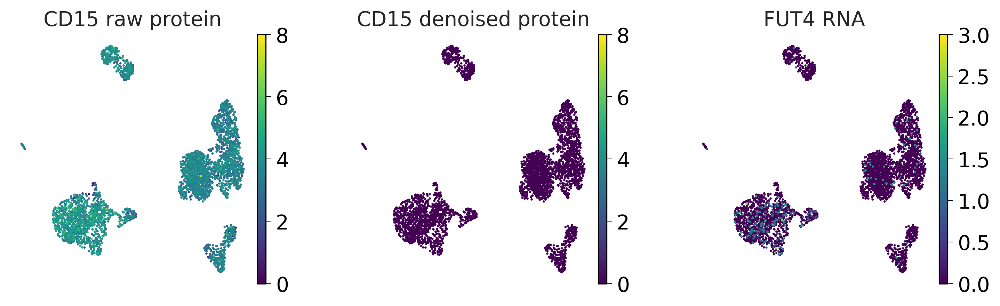

In [82]:
sc.settings.set_figure_params(dpi=150,figsize=(3, 3.1))
sc.pl.umap(tmp, size=10, color=["CD15 raw protein", "CD15 denoised protein", "FUT4 RNA"],
           palette=None, color_map="viridis",
           frameon=False,
           legend_loc="on data", legend_fontsize=5,
           ncols=3,
           vmax=[8,8,3], vmin=0, save='CITEseq_5k_PBMCs_CD15_protein_RNA.pdf') #legend_loc="right margin",

### UMAP others

In [83]:
sc.settings.set_figure_params(dpi=150,figsize=(3, 3.1))
sc.pl.umap(tmp, size=10, color=sorted_columns,
           palette=None, color_map="viridis",
           frameon=True,
           legend_loc="on data", legend_fontsize=5,
           ncols=9,
           vmax=vmax_list, vmin=0,save='CITEseq_5k_PBMCs_protein_RNA.pdf')

## protein-RNA pair correlation

In [84]:
from scipy.stats import spearmanr

In [85]:
plot_setting()

<Figure size 600x400 with 0 Axes>

In [86]:
sorted_idx = adata_processed.obs.sort_values('celltype_1').index

sorted_raw = fb_filtered.loc[sorted_idx].copy()

denoised_fb_filtered = pd.read_pickle('/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/CITEseq/5k_pbmc_protein_v3/scAR_out_fb/expected_natives.pickle')
sorted_denoise = denoised_fb_filtered.loc[sorted_idx].copy()
sorted_denoise.columns=sorted_denoise.columns.str.replace('_TotalSeqB', '')

adata_tmp = adata.copy()
sc.pp.normalize_total(adata_tmp, target_sum=1e4)
sorted_RNA = adata_tmp[:, list(set(mRNA_list.values()))][sorted_idx].to_df()

In [87]:
from scipy.sparse import csr_matrix

### Denoised counts
denoised_counts = pd.read_pickle('/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/CITEseq/5k_pbmc_protein_v3/scAR_out_mRNA/expected_natives.pickle')
adata_denoised =  adata.copy()
adata_denoised.X = csr_matrix(denoised_counts.values)

adata_tmp = adata_denoised.copy()
sc.pp.normalize_total(adata_tmp, target_sum=1e4)
sorted_RNA_denoised = adata_tmp[:, list(set(mRNA_list.values()))][sorted_idx].to_df()

In [88]:
corr_df = pd.DataFrame(index=mRNA_list.keys(), columns=['corr_RNA-protein', 'corr_RNA-denoised protein', 'corr_denoised RNA-denoised protein', 'pval_RNA-protein', 'pval_RNA-denoised protein', 'pval_denoised RNA-denoised protein'])
for prot in corr_df.index:
    corr_df.loc[prot,['corr_RNA-protein','pval_RNA-protein']] = spearmanr(sorted_raw[prot+'_raw'], sorted_RNA[mRNA_list[prot]])
    corr_df.loc[prot,['corr_RNA-denoised protein', 'pval_RNA-denoised protein']] = spearmanr(sorted_denoise[prot], sorted_RNA[mRNA_list[prot]])
    corr_df.loc[prot,['corr_denoised RNA-denoised protein', 'pval_denoised RNA-denoised protein']] = spearmanr(sorted_denoise[prot], sorted_RNA_denoised[mRNA_list[prot]])
    

/da/onc/bfx/research/shengca1/tools/anaconda3/envs/cropseq/lib/python3.8/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())


/da/onc/bfx/research/shengca1/tools/anaconda3/envs/cropseq/lib/python3.8/site-packages/IPython/core/pylabtools.py:137: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.canvas.print_figure(bytes_io, **kw)


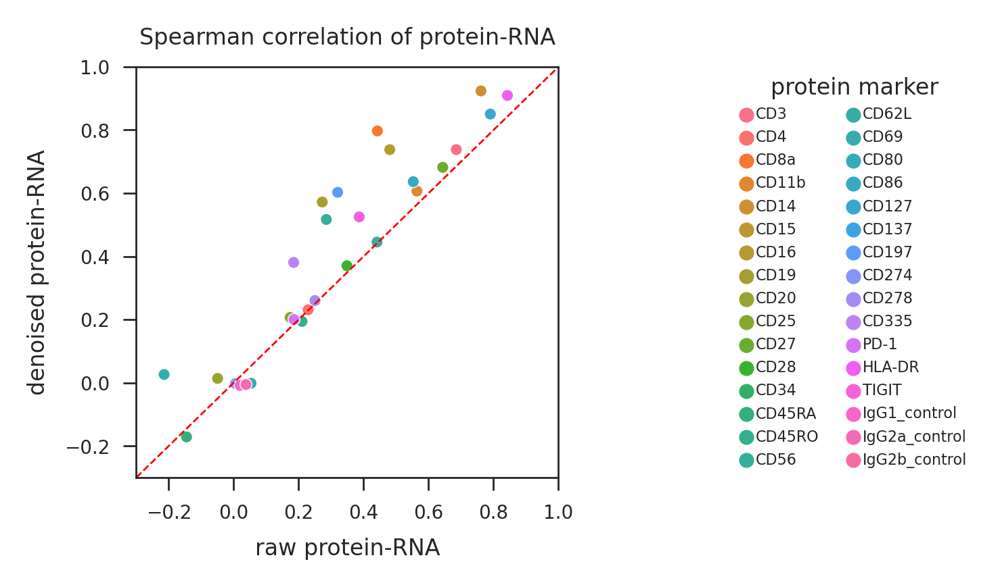

In [89]:
plt.figure(figsize = (2,2))
ax = sns.scatterplot(x= 'corr_RNA-protein', y= 'corr_RNA-denoised protein', hue='marker',data=corr_df.rename_axis('marker').reset_index(), s=10);
ax.plot([-0.3, 1],[-0.3, 1],ls='--',color='r',lw=0.5);
ax.set(xlim=(-0.3,1),ylim=(-0.3,1));
sns.move_legend(ax, "center right", bbox_to_anchor=(2, 0.5), ncol=2, title='protein marker', frameon=False, fontsize=4, markerscale=0.5, scatterpoints=1,);
ax.set(xlabel='raw protein-RNA', ylabel='denoised protein-RNA', title='Spearman correlation of protein-RNA');
# plt.savefig('/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/figures/Fig4_CITEseq_back/protein_RNA_correlation_20.11.2021.pdf')

/da/onc/bfx/research/shengca1/tools/anaconda3/envs/cropseq/lib/python3.8/site-packages/IPython/core/pylabtools.py:137: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  fig.canvas.print_figure(bytes_io, **kw)


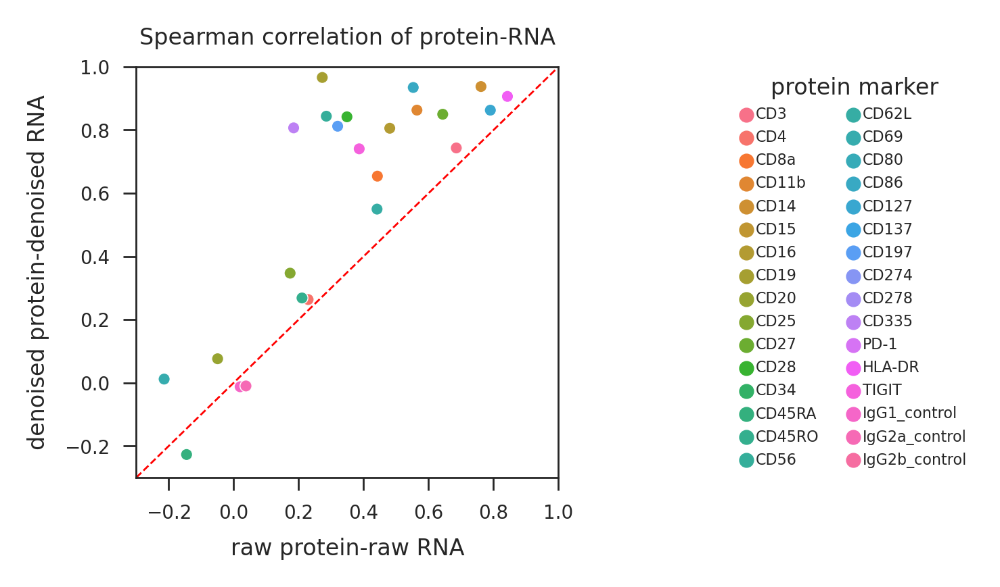

In [90]:
plt.figure(figsize = (2,2))
ax = sns.scatterplot(x= 'corr_RNA-protein', y= 'corr_denoised RNA-denoised protein', hue='marker',data=corr_df.rename_axis('marker').reset_index(), s=10);
ax.plot([-0.3, 1],[-0.3, 1],ls='--',color='r',lw=0.5);
ax.set(xlim=(-0.3,1),ylim=(-0.3,1));
sns.move_legend(ax, "center right", bbox_to_anchor=(2, 0.5), ncol=2, title='protein marker', frameon=False, fontsize=4, markerscale=0.5, scatterpoints=1,);
ax.set(xlabel='raw protein-raw RNA', ylabel='denoised protein-denoised RNA', title='Spearman correlation of protein-RNA');
# plt.savefig('/da/ONC/bfx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/figures/Fig6_scRNAseq/protein_RNA_correlation_denoised_both_20_11_2021.pdf')

In [91]:
tmp = corr_df[['corr_RNA-protein', 'corr_RNA-denoised protein', 'corr_denoised RNA-denoised protein']].unstack().to_frame('Spearman correlation')
tmp = tmp.rename_axis(['counts', 'markers']).reset_index()

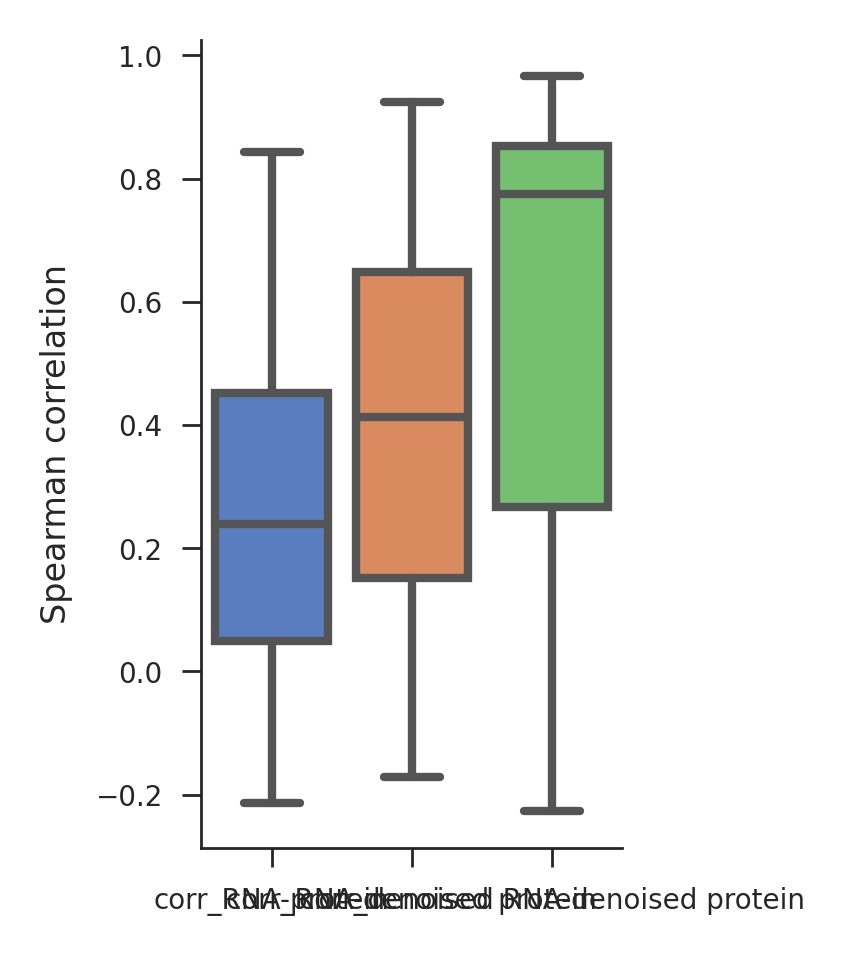

In [92]:
ax = sns.catplot(x = 'counts', 
                 y = 'Spearman correlation', 
                 data=tmp,
                 kind='box', height=2.5, aspect=0.8);
ax.set(xlabel='');
# plt.savefig('/da/ONC/bfx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/figures/Fig6_scRNAseq/protein_RNA_correlation_boxplot_all_20_11_2021.pdf')

## displot

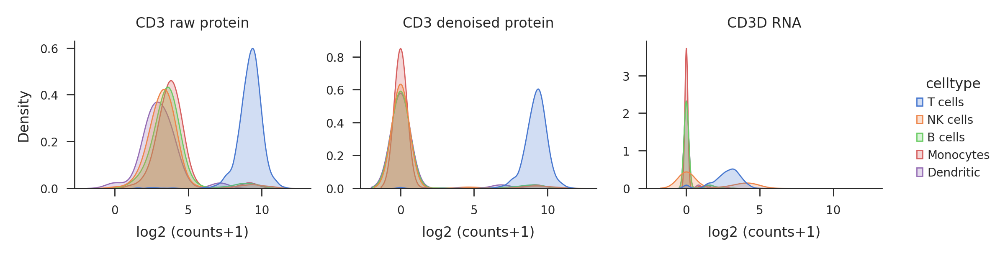

In [93]:
for marker in mRNA_list.keys():
    tmp = adata_processed.obs[['celltype', f'{marker}_raw', f'{marker}_scar', mRNA_list[marker]]]
    tmp.columns = tmp.columns.str.replace('_raw', ' raw protein').str.replace('_scar', ' denoised protein')
    tmp = tmp.rename(columns={ mRNA_list[marker]: mRNA_list[marker]+' RNA'})
    tmp = tmp.melt(id_vars=['celltype'], var_name='counts', value_name='log2 (counts+1)')
    tmp['antibody'] = marker
    ax = sns.displot(data=tmp, 
                 x="log2 (counts+1)",
                 hue="celltype",
                 kind="kde",
                 col = 'counts',
                 height=1.5,
                 aspect=1.2,
                 common_norm = False,
                 lw=0.5, 
                 fill=True,
                 facet_kws={'sharex': True, 'sharey': False}
                );
    ax.set_titles('{col_name}');
    break
    # ax.savefig(f'/da/ONC/BFx/research/shengca1/pipeline/obfx-fbdenoiser/manuscript/figures/Fig4_CITEseq_back/{marker}_kdeplot.pdf')